In [3]:
'''
!git clone https://github.com/openai/gym.git
%cd gym
!pip install -e .
%cd ..
'''

# instalar rSim
!apt-get update
!apt-get install qt5-default libode-dev
!cd build
!git clone https://github.com/robocin/rSim.git
%cd rSim
!mkdir buildc
%cd buildc
!ls
!cmake ..
!make -j4
%cd ..
!pip install -e .
%cd ..

# instalar rSoccer
!git clone https://github.com/robocin/rSoccer.git
%cd rSoccer
!pip install -e ./
%cd ..

# instalar a lib ptan
!pip install ptan

# libs de visualização
!pip install gym pyvirtualdisplay > /dev/null 2>&1
!apt-get install -y xvfb python-opengl ffmpeg > /dev/null 2>&1

# libs visualização em ML
# https://colab.research.google.com/github/wandb/examples/blob/master/colabs/pytorch/Simple_PyTorch_Integration.ipynb#scrollTo=qKitRLZsYzCP
#!pip install wandb
#!wandb login

Get:1 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ InRelease [3,626 B]
Ign:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Ign:3 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Get:4 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release [697 B]
Hit:5 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release
Get:6 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release.gpg [836 B]
Get:7 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Get:8 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ Packages [66.2 kB]
Hit:9 http://archive.ubuntu.com/ubuntu bionic InRelease
Get:10 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu bionic InRelease [15.9 kB]
Get:12 http://archive.ubuntu.com/ubuntu bionic-updates InRelease [88.7 kB]
Ign:13 https://developer.download.nvi

# **Agente** (Rede neural)

*   Output da rede Actor -> Retorna um vetor de médias (um para cada ação)
*   Output da rede Critic -> V(s,a)



In [1]:
from torch import nn
import ptan
import math

HID_SIZE = 64

class ModelActor(nn.Module):
    def __init__(self, obs_size, act_size):
        super(ModelActor, self).__init__()

        self.mu = nn.Sequential(
            nn.Linear(obs_size, HID_SIZE),
            nn.Tanh(),
            nn.Linear(HID_SIZE, HID_SIZE),
            nn.Tanh(),
            nn.Linear(HID_SIZE, act_size),
            nn.Tanh(),
        )
        self.logstd = nn.Parameter(torch.zeros(act_size))

    def forward(self, x):
        #print("actor input: " + str(x))
        out = self.mu(x)
        #print("actor output: " + str(out))
        return out


class ModelCritic(nn.Module):
    def __init__(self, obs_size):
        super(ModelCritic, self).__init__()

        self.value = nn.Sequential(
            nn.Linear(obs_size, HID_SIZE),
            nn.ReLU(),
            nn.Linear(HID_SIZE, HID_SIZE),
            nn.ReLU(),
            nn.Linear(HID_SIZE, 1),
        )

    def forward(self, x):
        #print("critic input: " + str(x))
        return self.value(x)

class AgentA2C(ptan.agent.BaseAgent):
    def __init__(self, net, device="cpu"):
        self.net = net
        self.device = device

    def __call__(self, states, agent_states):
        states_v = ptan.agent.float32_preprocessor(states)
        states_v = states_v.to(self.device)

        mu_v = self.net(states_v)
        mu = mu_v.data.cpu().numpy()
        logstd = self.net.logstd.data.cpu().numpy()
        rnd = np.random.normal(size=logstd.shape)
        actions = mu + np.exp(logstd) * rnd
        actions = np.clip(actions, -1, 1)
        return actions, agent_states

def test_net(net, env, count=10, device="cpu"):
    rewards = 0.0
    steps = 0
    for _ in range(count):
        obs = env.reset()
        while True:
            obs_v = ptan.agent.float32_preprocessor([obs]).to(device)
            mu_v = net(obs_v)[0]
            action = mu_v.squeeze(dim=0).data.cpu().numpy()
            action = np.clip(action, -1, 1)
            if np.isscalar(action): 
                action = [action]
            obs, reward, done, _ = env.step(action)
            for bot in reward.keys():
              rewards += reward[bot]
            steps += 1
            if done:
                break
    return rewards / count, steps / count

def calc_logprob(mu_v, logstd_v, actions_v):
    p1 = - ((mu_v - actions_v) ** 2) / (2*torch.exp(logstd_v).clamp(min=1e-3))
    p2 = - torch.log(torch.sqrt(2 * math.pi * torch.exp(logstd_v)))
    return p1 + p2



# **Parâmetros de treinamento**

In [2]:
import time
import numpy as np
import collections
import torch
import torch.nn as nn
import torch.optim as optim

DEFAULT_ENV_NAME = "SSLPassEnduranceMA-v0"

GAMMA = 0.99
GAE_LAMBDA = 0.95 # GAE_LAMBDA is the new constant that specifies the lambda factor in the advantage estimator

TRAJECTORY_SIZE = 2049
LEARNING_RATE_ACTOR = 1e-5
LEARNING_RATE_CRITIC = 1e-4

PPO_EPS = 0.4 # clipping value for the ratio of the new and the old policy
PPO_EPOCHES = 10 # for every batch of trajectory samples perform PPO_EPOCHS of the PPO objective
PPO_BATCH_SIZE = 64 #mini-batches

TEST_ITERS = 1000 # For every thousand observations obtained from the environment, we perform a test
                    #of 10 episodes to obtain the total reward and the count of steps for the current policy

cuda = True

#Conversão de dados de treino em tensores

In [3]:
def unpack_batch_a2c(batch, net, last_val_gamma, device="cpu"):
    """
    Convert batch into training tensors
    :param batch:
    :param net:
    :return: states variable, actions tensor, reference values variable
    """
    states = []
    actions = []
    rewards = []
    not_done_idx = []
    last_states = []
    for idx, exp in enumerate(batch):
        states.append(exp.state)
        actions.append(exp.action)
        rewards.append(exp.reward)
        if exp.last_state is not None:
            not_done_idx.append(idx)
            last_states.append(exp.last_state)
    states_v = ptan.agent.float32_preprocessor(states).to(device)
    actions_v = torch.FloatTensor(actions).to(device)

    # handle rewards
    rewards_np = np.array(rewards, dtype=np.float32)
    if not_done_idx:
        last_states_v = ptan.agent.float32_preprocessor(last_states).to(device)
        last_vals_v = net(last_states_v)
        last_vals_np = last_vals_v.data.cpu().numpy()[:, 0]
        rewards_np[not_done_idx] += last_val_gamma * last_vals_np

    ref_vals_v = torch.FloatTensor(rewards_np).to(device)
    return states_v, actions_v, ref_vals_v

# Advantage calculation

In [4]:
def calc_adv_ref(trajectory, net_crt, states_v, device="cpu"):
    """
    By trajectory calculate advantage and 1-step ref value
    :param trajectory: trajectory list
    :param net_crt: critic network
    :param states_v: states tensor
    :return: tuple with advantage numpy array and reference values
    """
    values_v = net_crt(states_v)
    values = values_v.squeeze().data.cpu().numpy()
    # generalized advantage estimator: smoothed version of the advantage
    last_gae = 0.0
    result_adv = []
    result_ref = []
    for val, next_val, (exp,) in zip(reversed(values[:-1]),reversed(values[1:]),reversed(trajectory[:-1])):
        if exp.done:
            delta = exp.reward - val
            last_gae = delta
        else:
            delta = exp.reward + GAMMA * next_val - val
            last_gae = delta + GAMMA * GAE_LAMBDA * last_gae
        result_adv.append(last_gae)
        result_ref.append(last_gae + val)

    adv_v = torch.FloatTensor(list(reversed(result_adv)))
    ref_v = torch.FloatTensor(list(reversed(result_ref)))
    return adv_v.to(device), ref_v.to(device)

# Dados de experiencia para MA

In [5]:
import collections
from collections import namedtuple, deque

# one single experience step
Experience = namedtuple('Experience', ['state', 'action', 'reward', 'done'])

def _group_list(items, lens):
    """
    Unflat the list of items by lens
    :param items: list of items
    :param lens: list of integers
    :return: list of list of items grouped by lengths
    """
    res = []
    cur_ofs = 0
    for g_len in lens:
        res.append(items[cur_ofs:cur_ofs+g_len])
        cur_ofs += g_len
    return res

class ExperienceSourceMA(ptan.experience.ExperienceSource):
    def __iter__(self):
        states, agent_states, histories, cur_rewards, cur_steps = [], [], [], [], []
        env_lens = []
        for env in self.pool:
            obs = env.reset()
            # if the environment is vectorized, all it's output is lists of results.
            # Details are here: https://github.com/openai/universe/blob/master/doc/env_semantics.rst
            if self.vectorized:
                obs_len = len(obs)
                states.extend(obs)
            else:
                obs_len = len(obs)
                states.extend(obs)
            env_lens.append(obs_len)

            for _ in range(obs_len):
                histories.append(deque(maxlen=self.steps_count))
                cur_rewards.append(0.0)
                cur_steps.append(0)
                agent_states.append(self.agent.initial_state())

        iter_idx = 0
        while True:
            actions = [None] * len(states)
            states_input = []
            states_indices = []
            for idx, state in enumerate(states):
                if state is None:
                    actions[idx] = self.pool[0].action_space.sample()  # assume that all envs are from the same family
                else:
                    states_input.append(state)
                    states_indices.append(idx)
            if states_input:
                #print(states_input)
                states_actions, new_agent_states = self.agent(states_input, agent_states)
                for idx, action in enumerate(states_actions):
                    g_idx = states_indices[idx]
                    actions[g_idx] = action
                    agent_states[g_idx] = new_agent_states[idx]
            grouped_actions = _group_list(actions, env_lens)
            
            global_ofs = 0
            for env_idx, (env, action_n) in enumerate(zip(self.pool, grouped_actions)):
                #print("action_current: " + str(action_n))
                if self.vectorized:
                    next_state_n, r_n, is_done_n, _ = env.step(action_n)
                else:
                    next_state, r, is_done, _ = env.step(action_n)
                    next_state_n, r_n, is_done_n = next_state, [r[key] for key in r.keys()], [is_done]*len(next_state)
                count_done = 0
                for ofs, (action, next_state, r, is_done) in enumerate(zip(action_n, next_state_n, r_n, is_done_n)):
                    idx = global_ofs + ofs
                    state = states[idx]
                    history = histories[idx]
                    cur_rewards[idx] += r
                    cur_steps[idx] += 1
                    if state is not None:
                        history.append(Experience(state=state, action=action, reward=r, done=is_done))
                    if len(history) == self.steps_count and iter_idx % self.steps_delta == 0:
                        yield tuple(history)
                    states[idx] = next_state
                    if is_done and count_done + 1 == len(r_n):
                        #print("here")
                        # in case of very short episode (shorter than our steps count), send gathered history
                        if 0 < len(history) < self.steps_count:
                            yield tuple(history)
                        # generate tail of history
                        while len(history) > 1:
                            history.popleft()
                            yield tuple(history)
                        self.total_rewards.append(cur_rewards[idx])
                        self.total_steps.append(cur_steps[idx])
                        cur_rewards[idx] = 0.0
                        cur_steps[idx] = 0
                        # vectorized envs are reset automatically
                        states[idx] = env.reset() if not self.vectorized else None
                        agent_states[idx] = self.agent.initial_state()
                        history.clear()
                global_ofs += len(action_n)
            iter_idx += 1


# Loop principal


In [10]:
import gym 
import rsoccer_gym
import ptan
import torch.nn.functional as F

device = torch.device("cuda" if cuda else "cpu")

save_path = "ppo"

env = gym.make(DEFAULT_ENV_NAME)
test_env = gym.make(DEFAULT_ENV_NAME)

net_act = ModelActor(env.observation_space.shape[1], env.action_space.shape[1]).to(device)
net_crt = ModelCritic(env.observation_space.shape[1]).to(device)

agent = AgentA2C(net_act, device=device)
exp_source = ExperienceSourceMA(env, agent, steps_count=1)

opt_act = optim.Adam(net_act.parameters(), LEARNING_RATE_ACTOR)
opt_crt = optim.Adam(net_crt.parameters(), LEARNING_RATE_CRITIC)

trajectory = []
best_reward = None
steps_ = []
rewards_ = []
for step_idx, exp in enumerate(exp_source):
  rewards_steps = exp_source.pop_rewards_steps()
  if rewards_steps:
    rewards, steps = zip(*rewards_steps)

  if step_idx % TEST_ITERS == 0:
    ts = time.time()
    rewards, steps = test_net(net_act, test_env, device=device)
    rewards_.append(rewards)
    steps_.append(step_idx)
    print("Test done in %.2f sec, reward %.3f, steps %d, total_steps %d" % (
        time.time() - ts, rewards, steps, step_idx))
    if best_reward is None or best_reward < rewards:
        if best_reward is not None:
          print("Best reward updated: %.3f -> %.3f" % (best_reward, rewards))
          torch.save(net_act.state_dict(), save_path + "-best.dat")
        best_reward = rewards

  trajectory.append(exp)
  if len(trajectory) < TRAJECTORY_SIZE:
    continue
  
  traj_states = [t[0].state for t in trajectory]
  traj_actions = [t[0].action for t in trajectory]
  traj_states_v = torch.FloatTensor(traj_states)
  traj_states_v = traj_states_v.to(device)
  traj_actions_v = torch.FloatTensor(traj_actions)
  traj_actions_v = traj_actions_v.to(device)
  traj_adv_v, traj_ref_v = calc_adv_ref(trajectory, net_crt, traj_states_v, device=device)
  mu_v = net_act(traj_states_v)
  old_logprob_v = calc_logprob(mu_v, net_act.logstd, traj_actions_v)

  # normalize advantages
  traj_adv_v = traj_adv_v - torch.mean(traj_adv_v)
  traj_adv_v /= torch.std(traj_adv_v)

  # drop last entry from the trajectory, an our adv and ref value calculated without it
  trajectory = trajectory[:-1]
  old_logprob_v = old_logprob_v[:-1].detach()

  sum_loss_value = 0.0
  sum_loss_policy = 0.0
  count_steps = 0

  for epoch in range(PPO_EPOCHES):
    for batch_ofs in range(0, len(trajectory),PPO_BATCH_SIZE):
      batch_l = batch_ofs + PPO_BATCH_SIZE
      states_v = traj_states_v[batch_ofs:batch_l]
      actions_v = traj_actions_v[batch_ofs:batch_l]
      batch_adv_v = traj_adv_v[batch_ofs:batch_l]
      batch_adv_v = batch_adv_v.unsqueeze(-1)
      batch_ref_v = traj_ref_v[batch_ofs:batch_l]
      batch_old_logprob_v = old_logprob_v[batch_ofs:batch_l]

      # critic training
      opt_crt.zero_grad()
      value_v = net_crt(states_v)
      loss_value_v = F.mse_loss(value_v.squeeze(-1), batch_ref_v)
      loss_value_v.backward()
      opt_crt.step()

      # actor training
      opt_act.zero_grad()
      mu_v = net_act(states_v)
      logprob_pi_v = calc_logprob(
          mu_v, net_act.logstd, actions_v)
      ratio_v = torch.exp(
          logprob_pi_v - batch_old_logprob_v)
      surr_obj_v = batch_adv_v * ratio_v
      c_ratio_v = torch.clamp(ratio_v,
                              1.0 - PPO_EPS,
                              1.0 + PPO_EPS)
      clipped_surr_v = batch_adv_v * c_ratio_v
      loss_policy_v = -torch.min(
          surr_obj_v, clipped_surr_v).mean()
      loss_policy_v.backward()
      opt_act.step()

      sum_loss_value += loss_value_v.item()
      sum_loss_policy += loss_policy_v.item()
      count_steps += 1

  trajectory.clear()
  if step_idx >= 5e6:
    break


Environment initialized
Environment initialized
Test done in 0.46 sec, reward -1.922, steps 20, total_steps 0
Test done in 0.51 sec, reward -1.964, steps 21, total_steps 1000
Test done in 0.48 sec, reward -1.937, steps 21, total_steps 2000
Test done in 0.47 sec, reward -2.034, steps 21, total_steps 3000
Test done in 0.46 sec, reward -2.030, steps 21, total_steps 4000
Test done in 0.51 sec, reward -1.881, steps 21, total_steps 5000
Best reward updated: -1.922 -> -1.881
Test done in 0.53 sec, reward -1.917, steps 21, total_steps 6000
Test done in 0.53 sec, reward -1.992, steps 21, total_steps 7000
Test done in 0.49 sec, reward -1.939, steps 21, total_steps 8000
Test done in 0.49 sec, reward -2.001, steps 19, total_steps 9000
Test done in 0.52 sec, reward -1.878, steps 21, total_steps 10000
Best reward updated: -1.881 -> -1.878
Test done in 0.54 sec, reward -1.887, steps 21, total_steps 11000
Test done in 0.50 sec, reward -1.935, steps 20, total_steps 12000
Test done in 0.50 sec, reward -

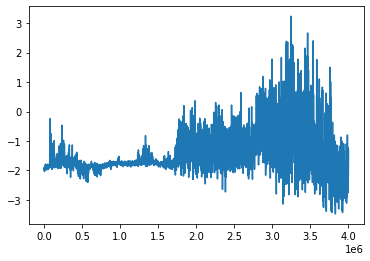

In [11]:
import matplotlib.pyplot as plt

plt.figure()
plt.plot(steps_,rewards_)   

# Agente treinado em ação

In [12]:
def show_gif(fname):
    import base64
    from IPython import display
    with open(fname, 'rb') as fd:
        b64 = base64.b64encode(fd.read()).decode('ascii')
    return display.HTML(f'<img src="data:image/gif;base64,{b64}" />')

Environment initialized



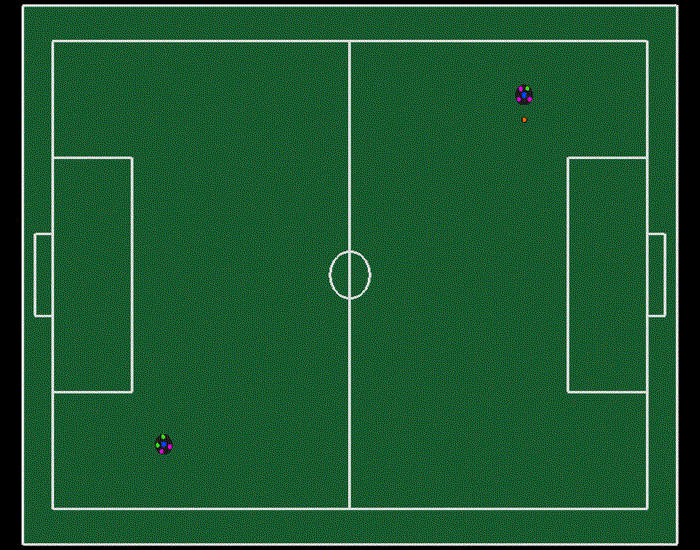

In [23]:
import gym
import ptan

from PIL import Image
import matplotlib.pyplot as plt
from IPython import display as ipythondisplay

from pyvirtualdisplay import Display
display = Display(visible=0, size=(200, 150))
display.start()

# ambiente
env = gym.make(DEFAULT_ENV_NAME)

# agente
net = ModelActor(env.observation_space.shape[1], env.action_space.shape[1]).to(device)
net.load_state_dict(torch.load("ppo-best.dat"))
net.eval()
agent = AgentA2C(net_act, device=device)

# start simulation
for i in range(1):
  done = False
  frames = []
  observation = env.reset()
  while not done:
    obs_v = torch.FloatTensor([observation])
    action, _ = agent(obs_v, [])
    observation, reward, done, info = env.step(action[0]) 
    screen = Image.fromarray(env.render(mode='rgb_array'))
    screen = screen.resize(size=(700, 550))
    frames.append(screen) 

env.close()

frames[0].save('episode.gif', format='GIF',
               append_images=frames[1:], save_all=True, loop = 100, duration =0.0001)

show_gif('episode.gif')

Agente com politica aleatória

Environment initialized



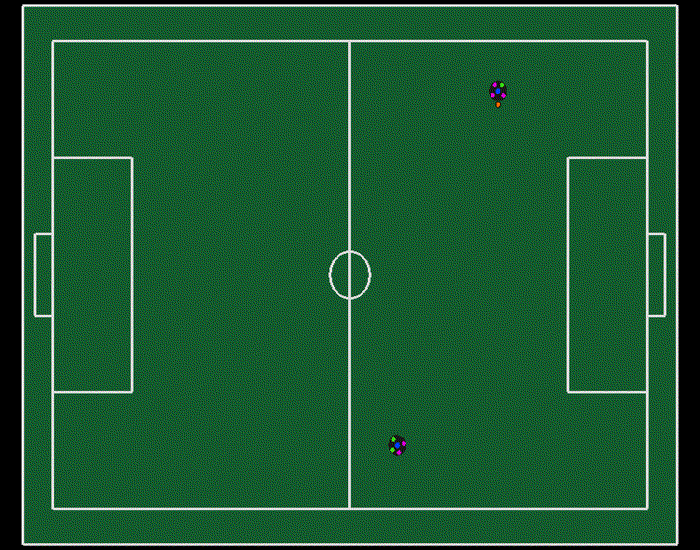

In [ ]:
import gym 
import rsoccer_gym

from PIL import Image
import matplotlib.pyplot as plt
from IPython import display as ipythondisplay

from pyvirtualdisplay import Display
display = Display(visible=0, size=(200, 150))
display.start()

#env = gym.make("SSLPassEnduranceMA-v0")
env = gym.make("SSLPassEndurance-v0")
observation = env.reset()
for i in range(1):
  done = False
  frames = []
  while not done:
    #env.render()
    action = env.action_space.sample()
    #print(action)
    observation, reward, done, info = env.step(action)   
    #print(observation)
    screen = Image.fromarray(env.render(mode='rgb_array'))
    screen = screen.resize(size=(700, 550))
    frames.append(screen)   
    #if done:
    #    observation = env.reset() 

env.close()
frames[0].save('episode.gif', format='GIF',
               append_images=frames[1:], save_all=True, loop = 100, duration =0.0001)

show_gif('episode.gif')